# Best profit basic example

The model setup for this example is available in the following formats:

- pyshop
    - [bp.py](#bp.py)
     


In [1]:
#Necessary imports used in all examples
import pandas as pd
import cufflinks as cf
import plotly.offline as py
import plotly.graph_objs as go
cf.go_offline()
py.offline.init_notebook_mode(connected=True)
from pyshop import ShopSession

#Functions used in this example for building a tunnel model, adding a gate to a tunnel and running the optimization
from bp import build_model, run_model

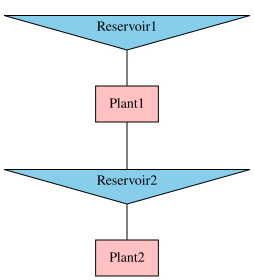

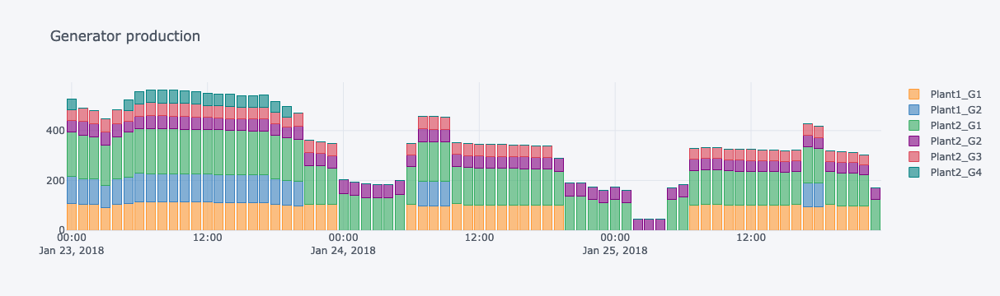

In [2]:
#Create a standard ShopSession
shop=ShopSession()
#Build a simple model with one plant with two equal generators and a second plant with one large and three small generators 
#by calling function "build_model" in bp.py
build_model(shop)
#Optimize model by calling "run_model" in tunnel_model.py
run_model(shop)
#Display topology to the screen
display(shop.model.build_connection_tree())
#Display results for generator production
pd.DataFrame([obj.production.get().rename(obj.get_name()) for obj in shop.model.generator]).transpose().iplot(title="Generator production", kind='bar', barmode = 'stack')

In [3]:
shop.print_bp_curves(["production"],["0","71"])

True

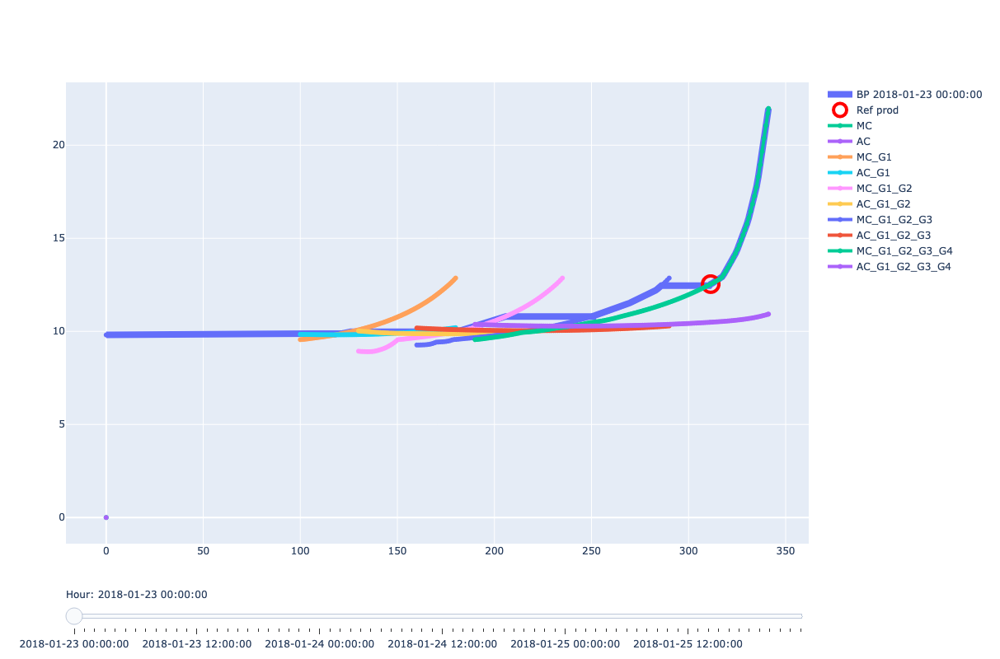

In [4]:
import plotly.graph_objects as go
from scipy.interpolate import interp1d
import numpy as np

# Create figure
fig = go.Figure()

fig.update_layout(
    width=1200,
    height=800
)

first_plant_name=shop.model.plant.get_object_names()[1]
plant=shop.model.plant[first_plant_name]
s1=plant.best_profit_mc.get()
ref_prod=plant.ref_prod.get()
ref_price2=pd.Series(index=ref_prod.index, dtype='float64')
for h in range(72):
    ref_price2.values[h] = interp1d(s1[h].index, s1[h].values, bounds_error=False, fill_value=(s1[h].values[0], s1[h].values[-1]))(ref_prod[h])
s1=plant.best_profit_mc.get()
last_hour=72

unit_comb=plant.unit_combinations
comb_mc=[]
comb_ac=[]
for comb in unit_comb:
    comb_mc.append(comb.marginal_cost.get())
    comb_ac.append(comb.average_cost.get())

for h in range(last_hour):
    fig.add_trace(go.Scatter(x=s1[h].index, y=s1[h].values, name='BP '+str(s1[h].name),mode='lines+markers', line=dict(width=8)))
    ref_price = interp1d(s1[h].index, s1[h].values, bounds_error=False, fill_value=(s1[h].values[0], s1[h].values[-1]))(ref_prod[h])
    fig.add_trace(go.Scatter(x=[ref_prod[h]], y=[ref_price], name='Ref prod', mode='markers',marker=dict(color='rgba(0,0,0, 0.0)', size=20, line=dict(color='Red', width=4))))           
    for comb_no, comb in enumerate(unit_comb):
        fig.add_trace(go.Scatter(x=comb_mc[comb_no][h].index, y=comb_mc[comb_no][h].values, name=comb.get_name().replace(plant.get_name(),'MC'), mode='lines+markers', line=dict(width=4)))
        #ac2 = ac.reset_index().drop_duplicates(subset='index',keep='last').set_index('index').interpolate(method='linear').iloc[1:]
        fig.add_trace(go.Scatter(x=comb_ac[comb_no][h].index, y=comb_ac[comb_no][h].values, name=comb.get_name().replace(plant.get_name(),'AC'), mode='lines+markers', line=dict(width=4)))

n_traces_per_timestep=2+2*len(unit_comb)

for n in range(len(fig.data)):
    fig.data[n].visible = False

for n in range(n_traces_per_timestep):
    fig.data[n].visible = True

# Create and add slider
steps = []
for i in range(int(len(fig.data)/n_traces_per_timestep)):
    step = dict(
        method="update",
        args=[{"visible": [False] * len(fig.data*n_traces_per_timestep)},
              {"title": "BP curve for " + first_plant_name + " " + str(s1[i].name)}],  # layout attribute
    )
    step["label"]=str(s1[i].name)
    for n in range(n_traces_per_timestep):
        step["args"][0]["visible"][i*n_traces_per_timestep+n] = True
    steps.append(step)

sliders = [dict(
    active=0,
    currentvalue={"prefix": "Hour: "},
    pad={"t": 50},
    steps=steps
)]

fig.update_layout(
    sliders=sliders
)

fig.show()

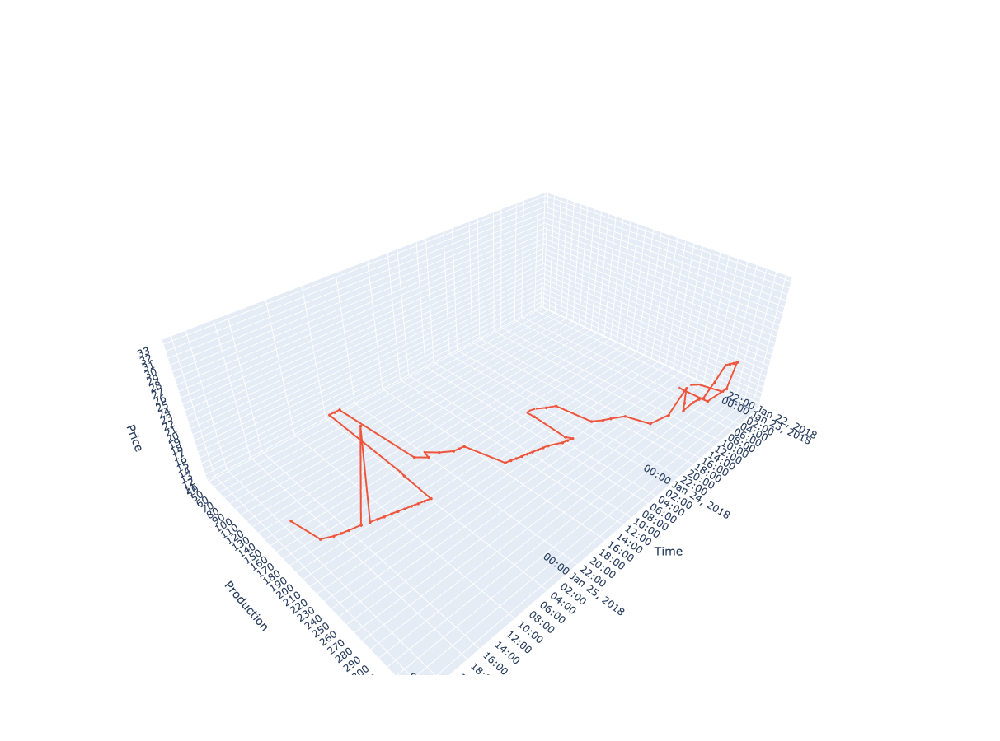

In [15]:
import plotly.graph_objects as go

import pandas as pd

df = pd.DataFrame()
fig = go.Figure()
fig.add_trace(go.Surface(x=df.columns.tolist(), y=df.index.tolist(), z=df.values.tolist(), colorscale="Viridis", hidesurface=True, contours_x_show=True, contours_y_show=True))
fig.update_traces(showscale=False)
fig.add_trace(go.Scatter3d(x=ref_prod.index, y=ref_prod.values, z=ref_price2.values, mode='lines+markers', line=dict(width=4), marker=dict(size=2)))#, colorscale="Viridis", hidesurface=True, contours_x_show=True, contours_y_show=True))

fig.update_layout(
    width=1000,
    height=900,
    autosize=True,
)
fig.update_scenes(
    aspectratio=dict(x=1.5, y=1, z=0.5),
    xaxis_title='Time',
    yaxis_title='Production',
    zaxis_title='Price'
)
fig.update_layout(
    scene = dict(
        xaxis = dict(nticks=72),
        yaxis = dict(nticks=35),
        zaxis = dict(nticks=25),
))

fig.show()

# Files

## bp.py

In [7]:
%pycat bp.py

import pandas as pd

def build_model(shop):
    starttime = pd.Timestamp('2018-01-23 00:00:00')
    endtime = pd.Timestamp('2018-01-26')
    shop.set_time_resolution(starttime=starttime, endtime=endtime, timeunit="hour", timeresolution=pd.Series(index=[starttime],data=[1]))
    
    rsv1 = shop.model.reservoir.add_object('Reservoir1')
    rsv1.max_vol.set(39)
    rsv1.lrl.set(860)
    rsv1.hrl.set(905)
    rsv1.vol_head.set(pd.Series([860, 906, 907], index=[0, 39, 41.66], name=0))    

    rsv2 = shop.model.reservoir.add_object('Reservoir2')
    rsv2.max_vol.set(97.5)   
    rsv2.lrl.set(650)   
    rsv2.hrl.set(679)    
    rsv2.vol_head.set(pd.Series([650, 679, 680], index=[0, 97.5, 104.15], name=0))
    
    plant1 = shop.model.plant.add_object('Plant1')
    plant1.outlet_line.set(672)
    plant1.main_loss.set([0])
    plant1.penstock_loss.set([0.001])
    plant1.mip_flag.set(1)
    for gen_no in range(2):
        gen=shop.model.generator.add_object(f"{plant1.get_name()}_G{str(gen_n